In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from astropy.table import Table
from astropy.table import vstack as tab_vstack

from lvmdap.dap_tools import list_columns,read_DAP_file,map_plot_DAP,scatter
from matplotlib import use as mpl_use
#mpl_use('Agg')

%matplotlib inline
from matplotlib import rcParams as rc
rc.update({'font.size': 19,\
           'font.weight': 900,\
           'text.usetex': True,\
           'path.simplify'           :   True,\
           'xtick.labelsize' : 19,\
           'ytick.labelsize' : 19,\
#           'xtick.major.size' : 3.5,\
#           'ytick.major.size' : 3.5,\
           'axes.linewidth'  : 2.0,\
               # Increase the tick-mark lengths (defaults are 4 and 2)
           'xtick.major.size'        :   6,\
           'ytick.major.size'        :   6,\
           'xtick.minor.size'        :   3,\
           'ytick.minor.size'        :   3,\
           'xtick.major.width'       :   1,\
           'ytick.major.width'       :   1,\
           'lines.markeredgewidth'   :   1,\
           'legend.numpoints'        :   1,\
           'xtick.minor.width'       :   1,\
           'ytick.minor.width'       :   1,\
           'legend.frameon'          :   False,\
           'legend.handletextpad'    :   0.3,\
           'font.family'    :   'serif',\
           'mathtext.fontset'        :   'stix',\
           'axes.facecolor' : "w",\
           
          })
import math
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as mpl_colors



In [2]:
#DIR_DAP = 'output_atocatl/'
#dap_file = 'dap-rsp108-sn20-00006110.dap.fits.gz'
#dap_file = 'dap-rsp108-sn20-00003735.dap.fits.gz'#dap-rsp108-sn20-00006112.dap.fits.gz'

#DIR_DAP = 'output_sim/'
#dap_file = '00006109_1700_1_1.0.dap.fits.gz'

DIR_DAP = 'orion/'
dap_file='com_orion_all.dap.fits.gz'

dap_file=f'{DIR_DAP}/{dap_file}'
tab_DAP=read_DAP_file(dap_file,verbose=True)


---- ALL Table Columns -----
-------------------------------
|        PT                   |
-------------------------------
id        dec       fiberid   
ra        mask      exposure  
----------------------------------
|        RSP                      |
----------------------------------
id             alpha          flux_st        Fe_MW          
MIN_CHISQ      e_alpha        redshift_st    e_Fe_MW        
Teff           Av_st          med_flux_st    alpha_MW       
e_Teff         e_Av_st        e_med_flux_st  e_alpha_MW     
Log_g          z_st           Teff_MW        vel_st         
e_Log_g        e_z_st         e_Teff_MW      log_ML         
Fe             disp_st        Log_g_MW       log_Mass       
e_Fe           e_disp_st      e_Log_g_MW                    
----------------------------------
|        PE_ord                   |
----------------------------------
id                 vel_pe_4340.49     e_disp_pe_6300.3   disp_pe_6716.44    
flux_pe_3726.03    e_vel_pe_4340.49 

In [3]:
#tab_DAP.add_column(dap_file,name='dap_file')
#tab_DAP['exposure','fiberid','dap_file']

In [4]:
def map_plot_DAP_rgb(tab_DAP,\
                     rgb_key=('flux_pe_6583.45','flux_pe_6562.85','flux_pe_5006.84'), \
                     rgb_scale=(1.0,1.0,1.0),\
                 vmin=0, vmax=0, titles=('r','g','b'), filename='junk',\
                fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None,fs=18):

    rc.update({'font.size': fs*fsize/5,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : fs*fsize/5,\
               'ytick.labelsize' : fs*fsize/5,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6,\
               'ytick.major.size'        :   6,\
               'xtick.minor.size'        :   3,\
               'ytick.minor.size'        :   3,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X= tab_DAP['ra'].value
    Y= tab_DAP['dec'].value
    R=tab_DAP[rgb_key[2]].value  
    G=tab_DAP[rgb_key[1]].value    
    B=tab_DAP[rgb_key[0]].value 
    R = R * rgb_scale[0]
    G = G * rgb_scale[1]
    B = B * rgb_scale[2]
    RGB = np.stack((R, G, B), axis=1)
    if (vmin==vmax):
        vmin=np.nanmin(RGB)
        vmax=np.nanmax(RGB)
    print(f'min/max:{vmin}/{vmax}')
    r = (R-vmin)/(vmax-vmin)
    g = (G-vmin)/(vmax-vmin)
    b = (B-vmin)/(vmax-vmin)

    r[r>1]=1
    r[r<0]=0
    b[b>1]=1
    b[b<0]=0
    r[r>1]=1
    r[r<0]=0    
    
    r = np.ma.filled(r, fill_value=0.0)
    g = np.ma.filled(g, fill_value=0.0)
    b = np.ma.filled(b, fill_value=0.0)

    r=r**gamma
    g=g**gamma
    b=b**gamma
    
#    print (r)
    r = np.ma.compressed(r)
    g = np.ma.compressed(g)
    b = np.ma.compressed(b)   


    #print(r,g,b)
    colors = np.stack((r, g, b), axis=1)
    colors[colors>1]=1
    colors[colors<0]=0
#    print(colors)
    fig,ax = plt.subplots(1,1,figsize=(fsize,fsize*0.95))
#    norm=mpl_colors.PowerNorm(vmin=0,vmax=1,gamma=gamma)
    scatter(X, Y, ax, color=colors, size=sf*35.6/3600)#, color=colors)
    ax.set_xlabel('Ra [deg]')#,fontsize=21)
    ax.set_ylabel('Dec [deg]')#,fontsize=21)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.06*(yy[1]-yy[0]),titles[0],fontsize=fs*(fsize/5),color='tomato')
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.12*(yy[1]-yy[0]),titles[1],fontsize=fs*(fsize/5),color='forestgreen')
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.18*(yy[1]-yy[0]),titles[2],fontsize=fs*(fsize/5),color='steelblue')

    if (tab_pt != None):
        for tap_pt_now in tab_pt:
            ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
    try:
        plt.show()
    except:
        plt_show=False
    fig.tight_layout()
    fig.savefig(f'{figs_dir}/{filename}.{fig_type}', facecolor='white')
    plt.close()
    return colors

def search_col(tab,key):
    a_keys=[]
    for keys in tab.columns:
        if (keys.find(key)>-1):
            print(keys)
            a_keys.append(keys)
    return a_keys

In [5]:
search_col(tab_DAP,'pe_5006')

flux_pe_5006.84
e_flux_pe_5006.84
disp_pe_5006.84
e_disp_pe_5006.84
vel_pe_5006.84
e_vel_pe_5006.84


['flux_pe_5006.84',
 'e_flux_pe_5006.84',
 'disp_pe_5006.84',
 'e_disp_pe_5006.84',
 'vel_pe_5006.84',
 'e_vel_pe_5006.84']

min/max:-1000/20000000.0


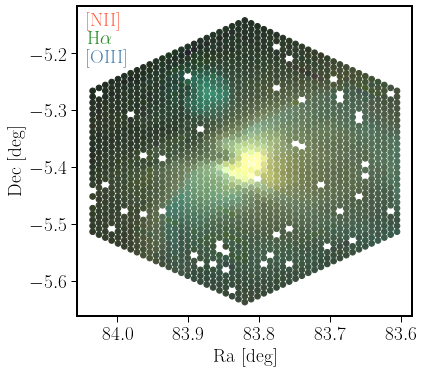

In [6]:
# 637.416/110230.7468
colors=map_plot_DAP_rgb(tab_DAP, \
                 rgb_key=('flux_pe_6583.45','flux_pe_6562.85','flux_pe_5006.84'), \
                 rgb_scale = (1,1,1), \
                 vmin=-1000, vmax=20000000.0,\
                 titles=('[NII]',r'H$\alpha$','[OIII]'), filename='orion',\
                 fsize=6, figs_dir='figs',gamma=0.25,fig_type='png',fs=16)

min/max:-1000/20000000.0


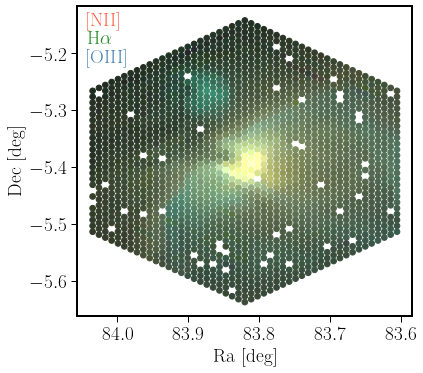

In [7]:
# 637.416/110230.7468
colors=map_plot_DAP_rgb(tab_DAP, \
                 rgb_key=('flux_[NII]_6583.45','flux_Halpha_6562.85','flux_[OIII]_5006.84'), \
                 rgb_scale = (1,1,1), \
                 vmin=-1000, vmax=20000000.0,\
                 titles=('[NII]',r'H$\alpha$','[OIII]'), filename='orion_PN',\
                 fsize=6, figs_dir='figs',gamma=0.25,fig_type='png',fs=16)

min/max:-1000/20000000.0


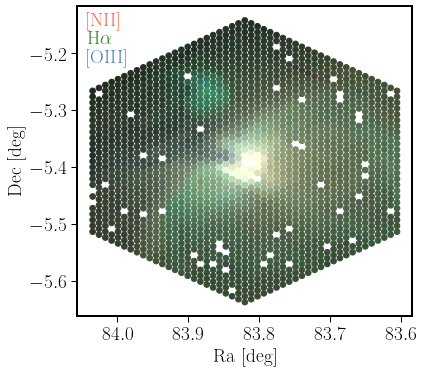

In [8]:
colors_t=map_plot_DAP_rgb(tab_DAP, \
                 rgb_key=('flux_[SIII]_9531.1','flux_Halpha_6562.85','flux_[OIII]_5006.84'), \
                 rgb_scale = (1,1,1), \
                 vmin=-1000, vmax=20000000.0,\
                 titles=('[NII]',r'H$\alpha$','[OIII]'), filename='orion_SIII',\
                 fsize=6, figs_dir='figs',gamma=0.25,fig_type='png',fs=16)

In [9]:
search_col(tab_DAP,'_373')

flux_HI_3734.37
vel_HI_3734.37
disp_HI_3734.37
EW_HI_3734.37
e_flux_HI_3734.37
e_vel_HI_3734.37
e_disp_HI_3734.37
e_EW_HI_3734.37


['flux_HI_3734.37',
 'vel_HI_3734.37',
 'disp_HI_3734.37',
 'EW_HI_3734.37',
 'e_flux_HI_3734.37',
 'e_vel_HI_3734.37',
 'e_disp_HI_3734.37',
 'e_EW_HI_3734.37']

In [10]:
search_col(tab_DAP,'flux_')

flux_st
med_flux_st
e_med_flux_st
flux_HI_3686.83
flux_HI_3691.56
flux_HI_3697.15
flux_HI_3703.85
flux_HI_3711.97
flux_[OII]_3726.03
flux_[OII]_3728.82
flux_HI_3734.37
flux_HI_3750.15
flux_[FeVII]_3758.9
flux_HI_3770.63
flux_HI_3797.9
flux_HeI_3819.61
flux_HI_3835.38
flux_[NeIII]_3868.75
flux_HeI_3888.65
flux_HI_3889.05
flux_CaII_3933.66
flux_HeI_3964.73
flux_[NeIII]_3967.46
flux_CaII_3968.47
flux_Hepsilon_3970.07
flux_HeI_4026.19
flux_[SII]_4068.6
flux_[SII]_4076.35
flux_Hdelta_4101.77
flux_HeI_4120.81
flux_[FeII]_4177.21
flux_[FeV]_4227.2
flux_[FeII]_4243.98
flux_CII_4267.0
flux_[FeII]_4287.4
flux_Hgamma_4340.49
flux_[FeII]_4358.1
flux_[FeII]_4358.37
flux_[FeII]_4359.34
flux_[OIII]_4363.21
flux_[FeII]_4413.78
flux_[FeII]_4414.45
flux_[FeII]_4416.27
flux_[FeII]_4452.11
flux_[FeII]_4457.95
flux_[FeII]_4470.29
flux_HeI_4471.48
flux_[FeII]_4474.91
flux_[NiII]_4485.21
flux_[MgI]_4562.48
flux_MgI]_4571.1
flux_[FeII]_4632.27
flux_[FeIII]_4658.1
flux_HeII_4685.68
flux_[FeIII]_4701.62
flux_[A

['flux_st',
 'med_flux_st',
 'e_med_flux_st',
 'flux_HI_3686.83',
 'flux_HI_3691.56',
 'flux_HI_3697.15',
 'flux_HI_3703.85',
 'flux_HI_3711.97',
 'flux_[OII]_3726.03',
 'flux_[OII]_3728.82',
 'flux_HI_3734.37',
 'flux_HI_3750.15',
 'flux_[FeVII]_3758.9',
 'flux_HI_3770.63',
 'flux_HI_3797.9',
 'flux_HeI_3819.61',
 'flux_HI_3835.38',
 'flux_[NeIII]_3868.75',
 'flux_HeI_3888.65',
 'flux_HI_3889.05',
 'flux_CaII_3933.66',
 'flux_HeI_3964.73',
 'flux_[NeIII]_3967.46',
 'flux_CaII_3968.47',
 'flux_Hepsilon_3970.07',
 'flux_HeI_4026.19',
 'flux_[SII]_4068.6',
 'flux_[SII]_4076.35',
 'flux_Hdelta_4101.77',
 'flux_HeI_4120.81',
 'flux_[FeII]_4177.21',
 'flux_[FeV]_4227.2',
 'flux_[FeII]_4243.98',
 'flux_CII_4267.0',
 'flux_[FeII]_4287.4',
 'flux_Hgamma_4340.49',
 'flux_[FeII]_4358.1',
 'flux_[FeII]_4358.37',
 'flux_[FeII]_4359.34',
 'flux_[OIII]_4363.21',
 'flux_[FeII]_4413.78',
 'flux_[FeII]_4414.45',
 'flux_[FeII]_4416.27',
 'flux_[FeII]_4452.11',
 'flux_[FeII]_4457.95',
 'flux_[FeII]_4470.

<ipython-input-11-36f14376afa7>:54: RuntimeWarning: invalid value encountered in log10
  O3=np.log10(OIII)-np.log10(Hb)
<ipython-input-11-36f14376afa7>:57: RuntimeWarning: invalid value encountered in log10
  O1=np.log10(OI/Ha)
<ipython-input-11-36f14376afa7>:81: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cm = plt.cm.get_cmap('viridis')


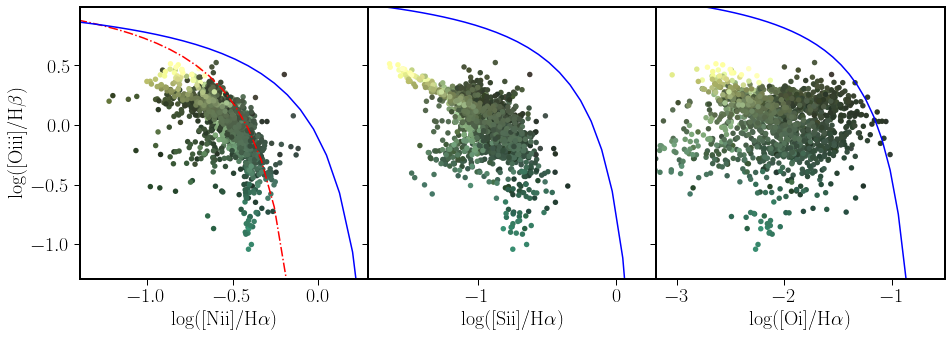

In [11]:
rc.update({'font.size': 20,\
           'font.weight': 900,\
           'text.usetex': True,\
           'path.simplify'           :   True,\
           'xtick.labelsize' : 20,\
           'ytick.labelsize' : 20,\
#           'xtick.major.size' : 3.5,\
#           'ytick.major.size' : 3.5,\
           'axes.linewidth'  : 2.0,\
               # Increase the tick-mark lengths (defaults are 4 and 2)
           'xtick.major.size'        :   6,\
           'ytick.major.size'        :   6,\
           'xtick.minor.size'        :   3,\
           'ytick.minor.size'        :   3,\
           'xtick.major.width'       :   1,\
           'ytick.major.width'       :   1,\
           'lines.markeredgewidth'   :   1,\
           'legend.numpoints'        :   1,\
           'xtick.minor.width'       :   1,\
           'ytick.minor.width'       :   1,\
           'legend.frameon'          :   False,\
           'legend.handletextpad'    :   0.3,\
           'font.family'    :   'serif',\
           'mathtext.fontset'        :   'stix',\
           'axes.facecolor' : "w",\
           
          })


mask_Ha = (tab_DAP['flux_Halpha_6562.85']>100) & (tab_DAP['flux_Halpha_6562.85']>50.0*tab_DAP['e_flux_Halpha_6562.85'])



Ha=tab_DAP['flux_Halpha_6562.85']
Hb=tab_DAP['flux_Hbeta_4861.36']
OIII=tab_DAP['flux_[OIII]_5006.84']
NII=tab_DAP['flux_[NII]_6583.45']
SII=tab_DAP['flux_[SII]_6716.44']+tab_DAP['flux_[SII]_6730.82']
OI=tab_DAP['flux_[OI]_6300.3']
#tab_DAP['flux_pe_3726.03']+tab_DAP['flux_pe_3728.82']

map_dist=np.arange(len(Ha))

eHa=tab_DAP['e_flux_Halpha_6562.85']
eHb=tab_DAP['e_flux_Hbeta_4861.36']
eOIII=tab_DAP['e_flux_[OIII]_5006.84']
eNII=tab_DAP['e_flux_[NII]_6583.45']
eSII=np.sqrt(tab_DAP['e_flux_[SII]_6716.44']**2+tab_DAP['e_flux_[SII]_6730.82']**2)
eOI=tab_DAP['flux_[OI]_6300.3']
#tab_DAP['e_flux_pe_3726.03']+tab_DAP['e_flux_pe_3728.82']

#tab_DAP['e_flux_pe_9531.1']

O3=np.log10(OIII)-np.log10(Hb)
N2=np.log10(NII)-np.log10(Ha)
S2=np.log10(SII/Ha)
O1=np.log10(OI/Ha)
lEW_Ha = np.log10(np.abs(tab_DAP['EW_Halpha_6562.85']))
e_lEW_Ha = 0.4*np.abs(tab_DAP['e_EW_Halpha_6562.85']/tab_DAP['EW_Halpha_6562.85'])
nx = 2.5 #np.max(tab_DAP[mask_Ha]['R_Re'])
#
#
#
fig, axes = plt.subplots(1,3,figsize=(15.5,5), sharey=True, squeeze=False)
x_min1=-1.39
x_max1=0.29
y_min1=-1.29
y_max1=0.99

x=np.linspace(5*x_min1,2*x_max1,100)
cut_y=-0.7+0.2-3.67*x
cut_y2=-1.7+0.5-3.67*x
cut_y3=0.61/(x-0.05)+1.3
cut_y4=0.61/(x-0.47)+1.19
cut_y_SII=0.61/(x-0.3)+1.3;
cut_y_SII=0.61/(x-0.3)+1.3;
cut_y_SII_AGNs=1.89*(x)+0.76;
cut_y_OI=0.73/((x+0.59))+1.33;#+1.10;
cut_y_OI_AGNs=1.18*(x)+1.30;
cut_y_OIII_AGNs=1.14*(x)+0.36;
cm = plt.cm.get_cmap('viridis')
cax1=axes[0,0].scatter(N2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)
#                       c=map_dist[mask_Ha], marker='o', s=30, alpha=0.35, cmap=cm, vmin=0, vmax=nx)
cax2=axes[0,1].scatter(S2[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)
cax3=axes[0,2].scatter(O1[mask_Ha],O3[mask_Ha],color=colors[mask_Ha],edgecolor='None',s=30)

#axes[0,0].scatter(N2,O3,alpha=0.75, marker='*', s=100,c='green')
#axes[0,1].scatter(S2,O3,alpha=0.75, marker='*', s=100,c='green')
#axes[0,2].scatter(O1,O3,alpha=0.75, marker='*', s=100,c='green')

axes[0,0].plot(x[x<0],cut_y3[x<0],'r-.')
axes[0,0].plot(x,cut_y4,'b-')
axes[0,1].plot(x[x<0.2],cut_y_SII[x<0.2],'b-')
axes[0,2].plot(x[x<-0.6],cut_y_OI[x<-0.6],'b-')


#plt.rcParams.update({'font.size': 16})
axes[0,0].set_ylabel(r'log([Oiii]/H$\beta$)')
axes[0,0].set_xlabel(r'log([Nii]/H$\alpha$)')
axes[0,1].set_xlabel(r'log([Sii]/H$\alpha$)')
axes[0,2].set_xlabel(r'log([Oi]/H$\alpha$)')
axes[0,0].set_xlim(x_min1,x_max1)
axes[0,1].set_xlim(x_min1-0.4,x_max1)
axes[0,2].set_xlim(x_min1-1.8,x_max1-0.8)
axes[0,0].set_ylim(y_min1,y_max1)




plt.subplots_adjust(wspace=0)

plt.tight_layout
fig.savefig(f'figs/BPT_ORION.png', facecolor='white')
plt.show()

#cax1=axes[0,2].scatter(N2[mask_Ha],O3[mask_Ha],c=log_EW_Ha[mask_Ha], marker='o', s=30, alpha=0.35, cmap=cm, vmin=-3, vmax=2.5)
#axes[0,2].plot(x[x<0],cut_y3[x<0],'r-.')
#axes[0,2].plot(x,cut_y4,'b-')
#cb1=add_colorbar(cax1)
#cb1.set_label(r'$log|EW(H\alpha)|$')

In [12]:
#
# Lines with enough S/N
#
#tab_sum_flux=Table()
name_cols=[]
w_sum = []
sum_flux=[]
e_sum_flux=[]


col_flux=search_col(tab_DAP,'flux_')
print ('------------------------------------\n')
#col_flux_np=[]
for cols in col_flux:
#    print (cols,cols.find('e_'))
    if ((cols.find('e_')==-1) and (cols.find('pe_')==-1) and (cols.find('st')==-1)):
        a_cols=cols.split('_') 
        w_now=a_cols[-1]
        e_cols='e_'+cols
        name_cols.append(cols)
        w_sum.append(float(w_now))
        sum_flux_now=np.nansum(tab_DAP[cols])
        e_sum_flux_now=np.sqrt(np.nansum((tab_DAP[e_cols]**2)))
        sum_flux.append(sum_flux_now)
        e_sum_flux.append(e_sum_flux_now)

name_cols=np.array(name_cols)
sum_flux=np.array(sum_flux)
e_sum_flux=np.array(e_sum_flux)
tab_sum_flux=Table((name_cols,w_sum,sum_flux,e_sum_flux),names=('eline','wave','flux','e_flux'))


flux_st
med_flux_st
e_med_flux_st
flux_HI_3686.83
flux_HI_3691.56
flux_HI_3697.15
flux_HI_3703.85
flux_HI_3711.97
flux_[OII]_3726.03
flux_[OII]_3728.82
flux_HI_3734.37
flux_HI_3750.15
flux_[FeVII]_3758.9
flux_HI_3770.63
flux_HI_3797.9
flux_HeI_3819.61
flux_HI_3835.38
flux_[NeIII]_3868.75
flux_HeI_3888.65
flux_HI_3889.05
flux_CaII_3933.66
flux_HeI_3964.73
flux_[NeIII]_3967.46
flux_CaII_3968.47
flux_Hepsilon_3970.07
flux_HeI_4026.19
flux_[SII]_4068.6
flux_[SII]_4076.35
flux_Hdelta_4101.77
flux_HeI_4120.81
flux_[FeII]_4177.21
flux_[FeV]_4227.2
flux_[FeII]_4243.98
flux_CII_4267.0
flux_[FeII]_4287.4
flux_Hgamma_4340.49
flux_[FeII]_4358.1
flux_[FeII]_4358.37
flux_[FeII]_4359.34
flux_[OIII]_4363.21
flux_[FeII]_4413.78
flux_[FeII]_4414.45
flux_[FeII]_4416.27
flux_[FeII]_4452.11
flux_[FeII]_4457.95
flux_[FeII]_4470.29
flux_HeI_4471.48
flux_[FeII]_4474.91
flux_[NiII]_4485.21
flux_[MgI]_4562.48
flux_MgI]_4571.1
flux_[FeII]_4632.27
flux_[FeIII]_4658.1
flux_HeII_4685.68
flux_[FeIII]_4701.62
flux_[A

54


eline,wave,flux,e_flux,SN
str21,float64,float64,float64,float64
flux_Halpha_6562.85,6562.85,1761148617.5711508,110723.62315950384,15905.80733647158
flux_[OIII]_5006.84,5006.84,1039104482.4891306,4368818.757085301,237.845637520193
flux_[SIII]_9531.1,9531.1,722250970.1893675,76090.367603254,9492.015782540135
flux_[OII]_3728.82,3728.82,646562513.3169507,516391.35387679073,1252.0785029859705
flux_Hbeta_4861.36,4861.36,609819427.8317934,104739.55986596033,5822.245468781855
flux_[OII]_3726.03,3726.03,442536509.9906911,354038.7643717237,1249.9662594179915
flux_[NII]_6583.45,6583.45,431873941.6710035,1093481.2975512503,394.953203715642
flux_[OIII]_4958.91,4958.91,328365535.8111751,13426735.327039182,24.456096572478216
flux_[SIII]_9069.0,9069.0,263249369.04641104,192750.8477324411,1365.7494747407259


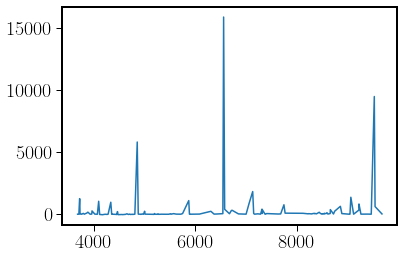

In [13]:
#tab_sum_flux
SN = tab_sum_flux['flux']/tab_sum_flux['e_flux']
try:
    tab_sum_flux.add_column(SN,name='SN')
except:
    print('SN not needed')
plt.plot(tab_sum_flux['wave'],SN)
tab_sum_good = tab_sum_flux[SN>45]
print(len(tab_sum_good))

tab_sum_flux.sort('flux',reverse=True)

#search_col(tab_DAP,'Halpha')
#SN_Ha=SN[tab_sum_flux['wave']==6562.85]

tab_sum_flux[0:36]

In [14]:
def map_plot_DAP(tab_DAP,line='flux_Halpha_6562.85', \
                 vmin=0, vmax=0, title=None, filename='junk',\
                 cmap='Spectral', fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None):

    rc.update({'font.size': 19,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : 19,\
               'ytick.labelsize' : 19,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6,\
               'ytick.major.size'        :   6,\
               'xtick.minor.size'        :   3,\
               'ytick.minor.size'        :   3,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X=tab_DAP['ra']
    Y=tab_DAP['dec']
    C=tab_DAP[line]    
    if (title== None):
        title=line.replace("_"," ")
        title=line.replace("_"," ")
    if (vmin==vmax):
        vmin=0.00001*np.nanmax(C)
        vmax=np.nanmax(C)
    print(line,vmin,vmax)
    fig,ax = plt.subplots(1,1,figsize=(fsize,fsize/1.3))
    norm=mpl_colors.PowerNorm(vmin=vmin,vmax=vmax,gamma=gamma)
    scat=scatter(X, Y, ax, size=sf*35.6/3600, c=C, cmap=cmap, norm=norm)
#    scat=scatter(X, Y, ax, size=35.6/3600, c=C,vmin = vmin, vmax = vmax, cmap=cmap, norm=colors.PowerNorm(gamma=gamma))
    ax.set_xlabel('Ra [deg]')#,fontsize=21)
    ax.set_ylabel('Dec [deg]')#,fontsize=21)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    props = dict(boxstyle='square', facecolor='white', alpha=0.5)
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.08*(yy[1]-yy[0]),title,color='black',\
            bbox=props)
    ax.text(xx[1]-0.52*(xx[1]-xx[0]),yy[0]+0.06*(yy[1]-yy[0]),r'10$^{-16}$ erg/s/cm$^2$',color='black',\
            bbox=props)
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(scat.sc, cax=cax, format='%.0e')#,label=fr'{title}')#,fontsize=21)
    if (tab_pt != None):
        for tap_pt_now in tab_pt:
            ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
    try:
        plt.show()
    except:
        plt_show=False
    fig.tight_layout()
    fig.savefig(f'{figs_dir}/{filename}.{fig_type}')
    plt.close()


In [15]:
def map_plot_DAP_ax(tab_DAP,ax=None,fig=None,line='flux_Halpha_6562.85', \
                 vmin=0, vmax=0, title=None, filename='junk',\
                 cmap='Spectral', fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None,xlab=True,ylab=True, fs=1.0,f_scale=1e7):

    rc.update({'font.size': 19*fs,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : 19*fs,\
               'ytick.labelsize' : 19*fs,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6*fs,\
               'ytick.major.size'        :   6*fs,\
               'xtick.minor.size'        :   3*fs,\
               'ytick.minor.size'        :   3*fs,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X=tab_DAP['ra']
    Y=tab_DAP['dec']
    C=tab_DAP[line]/f_scale    
    if (title== None):
        title=line.replace("_"," ")
        title=line.replace("_"," ")
    if (vmin==vmax):
        vmin=0.00001*np.nanmax(C)
        vmax=np.nanmax(C)
#    print(line,vmin,vmax)
    #fig,ax = plt.subplots(1,1,figsize=(fsize,fsize/1.3))
    norm=mpl_colors.PowerNorm(vmin=vmin,vmax=vmax,gamma=gamma)
    size_sc = sf*35.6/3600
#    print(size_sc)
    scat=ax.scatter(X, Y, s=10*sf, c=C, cmap=cmap, norm=norm, rasterized=True)
#    scat=scatter(X, Y, ax=ax, size=sf*35.6/3600, c=C, cmap=cmap, norm=norm, rasterized=True)
#    scat=scatter(X, Y, ax, size=35.6/3600, c=C,vmin = vmin, vmax = vmax, cmap=cmap, norm=colors.PowerNorm(gamma=gamma))
    if (xlab == True):
        ax.set_xlabel('Ra [deg]',fontsize=19*fs)
    if (ylab == True):
        ax.set_ylabel('Dec [deg]',fontsize=19*fs)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    props = dict(boxstyle='square', facecolor='white', alpha=0.5)
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.08*fs*(yy[1]-yy[0]),rf'{title}',color='black',\
            bbox=props)
#    ax.text(xx[1]-0.52*(xx[1]-xx[0]),yy[0]+0.06*(yy[1]-yy[0]),r'10$^{-16}$ erg/s/cm$^2$',color='black',\
#            bbox=props)
    return scat
    #divider = make_axes_locatable(ax)
    #cax = divider.append_axes("right", size="5%", pad=0.05)
    #plt.colorbar(scat, cax=cax, format='%.0e')#,label=fr'{title}')#,fontsize=21)
    #if (tab_pt != None):
    #    for tap_pt_now in tab_pt:
    #        ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
#    try:
#        plt.show()
#    except:
#        plt_show=False
#    fig.tight_layout()
#    fig.savefig(f'{figs_dir}/{filename}.{fig_type}')
#    plt.close()


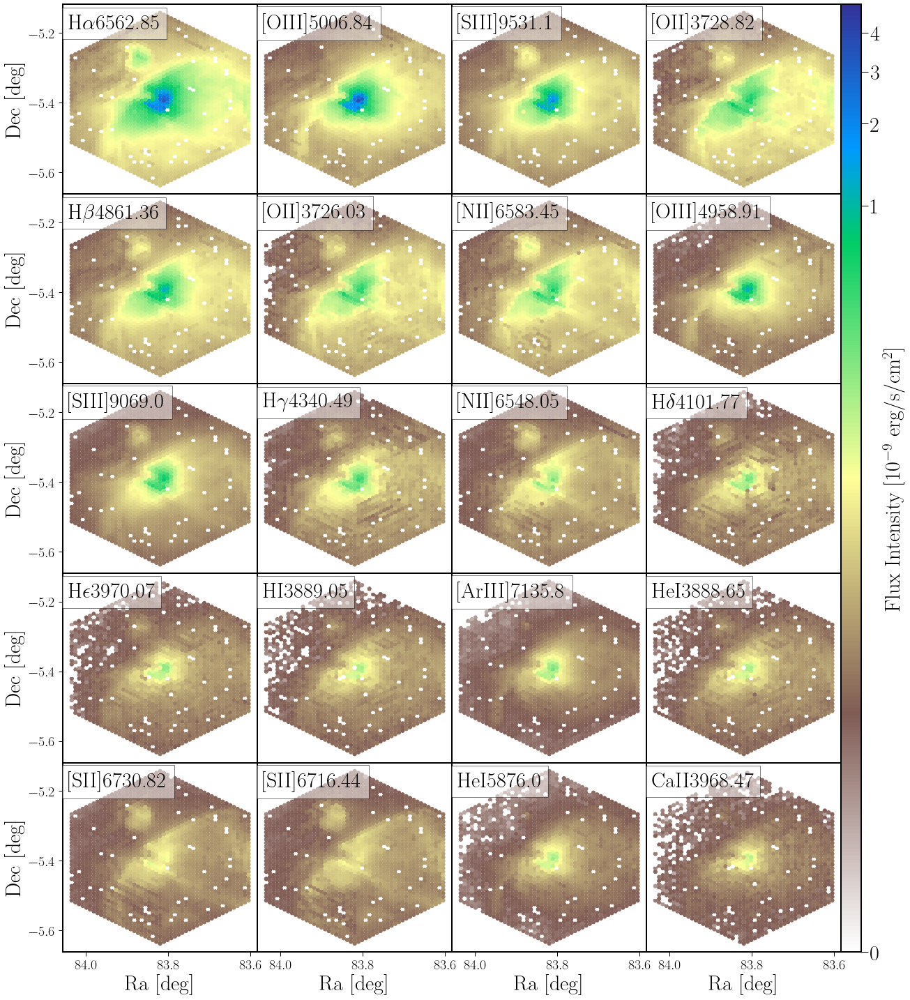

In [16]:
#cmap='gnuplot2_r'
gamma=0.15
#cmap='pink_r'
#cmap='Spectral'
#cmap='nipy_spectral_r'
#cmap='cubehelix_r'
cmap='terrain_r'
#cmap='gist_earth_r'
#fig = plt.figure()
NX=4
NY=5
fs=1.6
f_scale=1e7
fig, axs = plt.subplots(nrows=NY, ncols=NX, figsize=(5*NX, 5*NY))#/1.3))


#axs_flat = axs.flatten
for I,ax in enumerate(np.ravel(axs)):
    #print(ax)
    tab_now=tab_sum_flux[I]
    eline=tab_now['eline']
    wave=np.ceil(tab_now['wave'])
    II=str(I)
    if (I<10):
        II='0'+str(I)
    filename=f'30dor_{II}_{wave}'
    title=eline.replace('flux_','')
    title=title.replace('_','')
    title=title.replace('flux','')
    title=title.replace('alpha','$\\alpha$')
    title=title.replace('beta','$\\beta$')
    title=title.replace('gamma','$\\gamma$')    
    title=title.replace('delta','$\\delta$')
    title=title.replace('epsilon','$\\epsilon$')    
    xlab = False
    ylab = False
    if ((I/NX)==int(I/NX)):
        ylab=True
    else:
        ax.set_yticks([])
    if (I>=(NX*NY-4)):
        xlab=True
    else:
        ax.set_xticks([])
    vmin=0
    vmax=0.49e8
#    vmax=8e5

    scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                 vmin=0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    #print(xx,yy)
    
#divider = make_axes_locatable(ax)
#cax = divider.append_axes("right", size="5%", pad=0.05)    
cax = fig.add_axes([0.9, 0.125, 0.02, 0.755])  # Ajusta estos valores según necesites
cbar = fig.colorbar(scat, cax=cax, ax=axs.ravel().tolist(), orientation='vertical')#, format='%.0e')
cbar.set_label('Flux Intensity [10$^{-9}$ erg/s/cm$^2$]')

plt.subplots_adjust(wspace=0,hspace=0)
plt.show()    
#fig.tight_layout(w_pad=0.2)
fig.savefig(f'figs/ORION_felines.pdf', facecolor='white')

#if (I>3):
    #    break

In [17]:
plt.show()

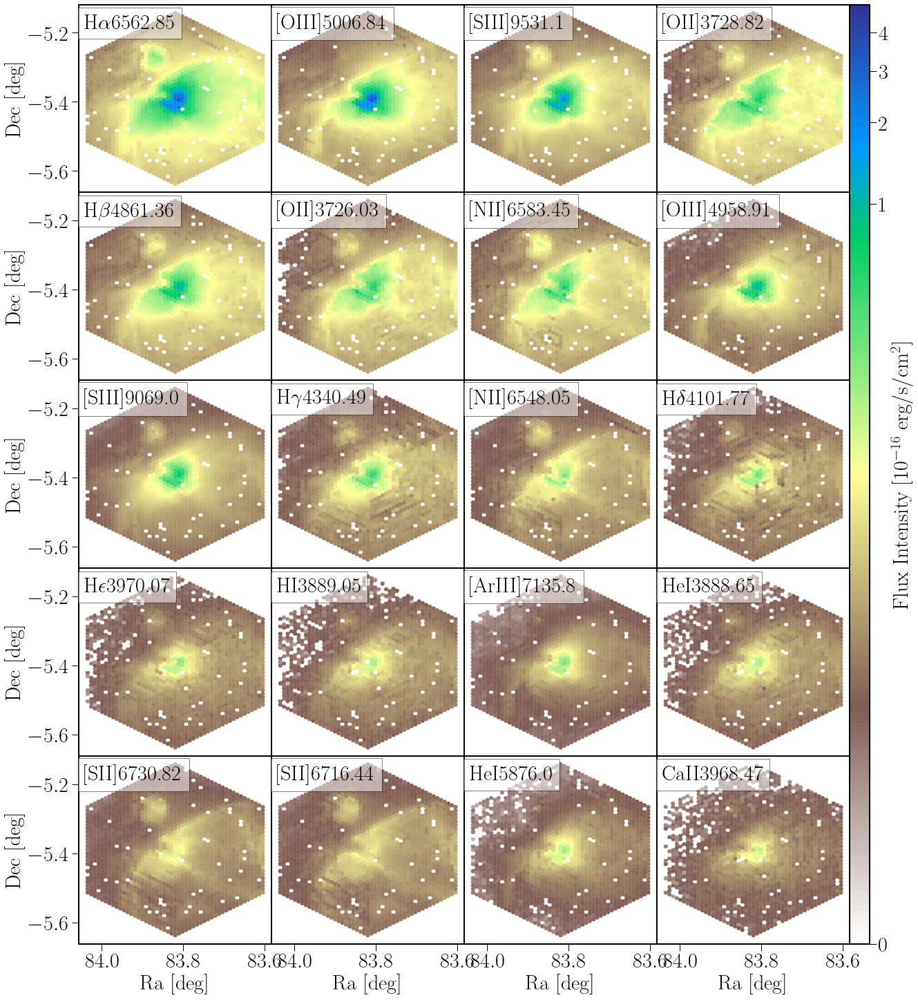

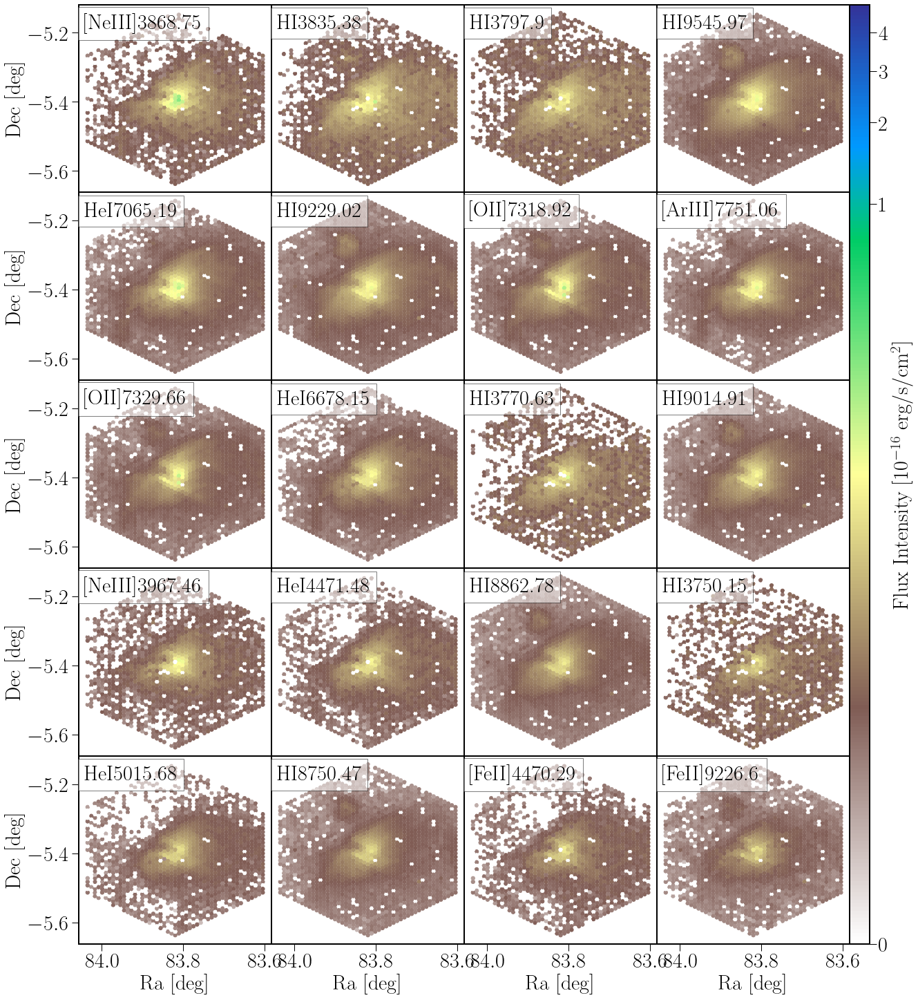

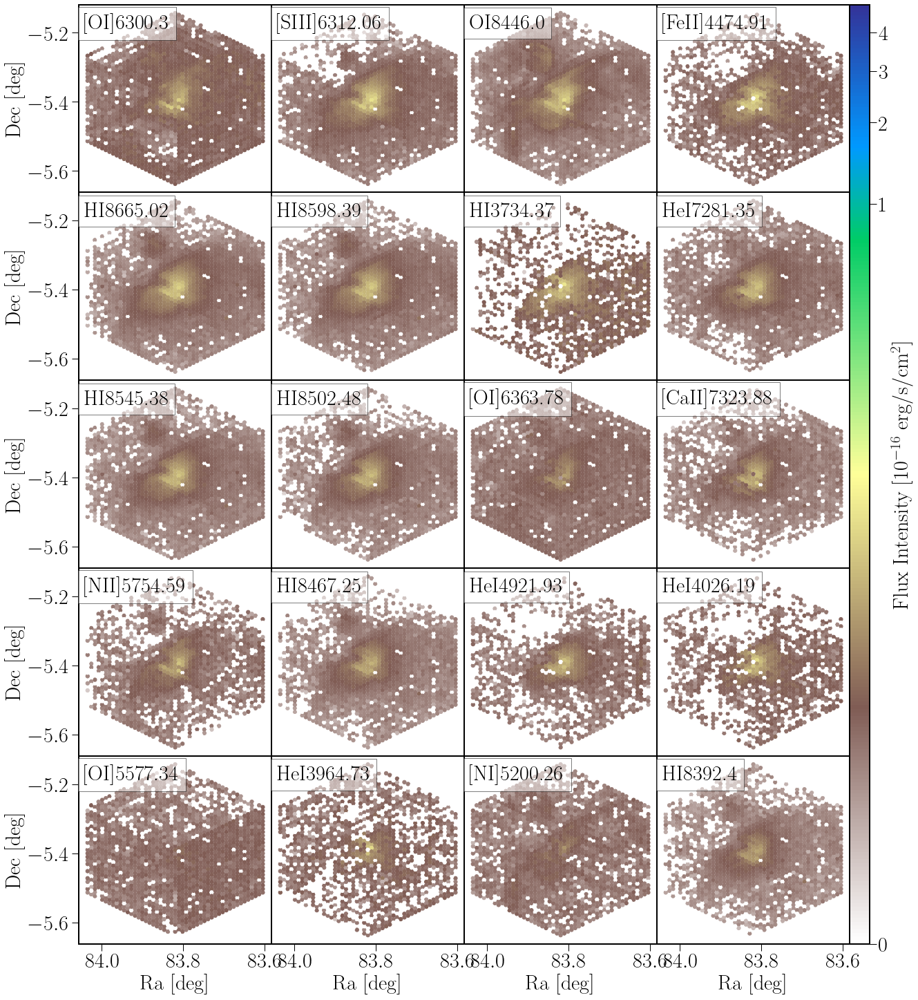

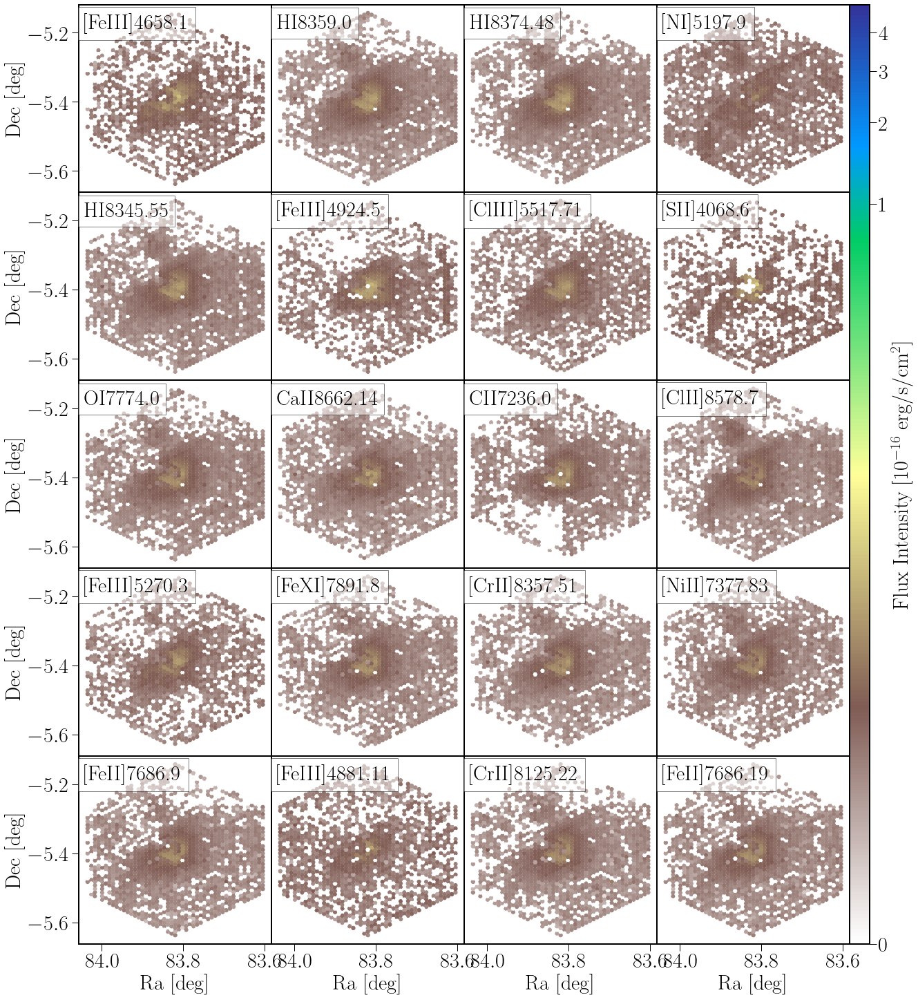

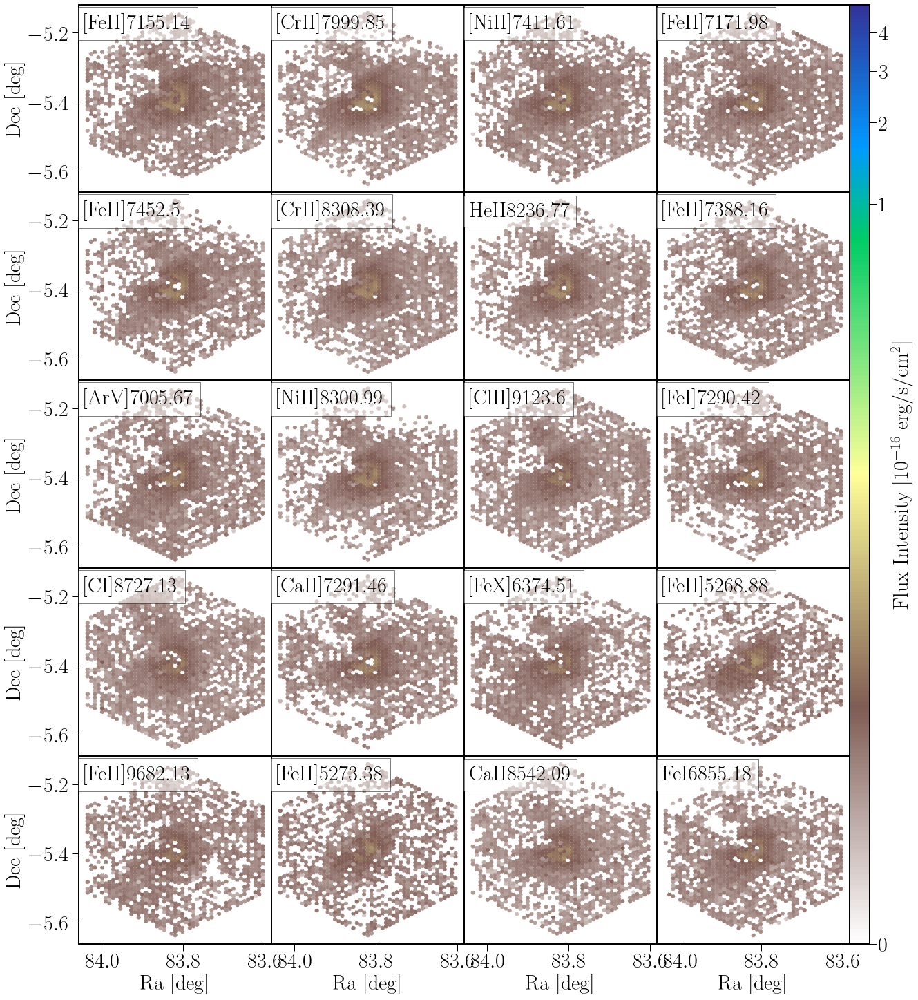

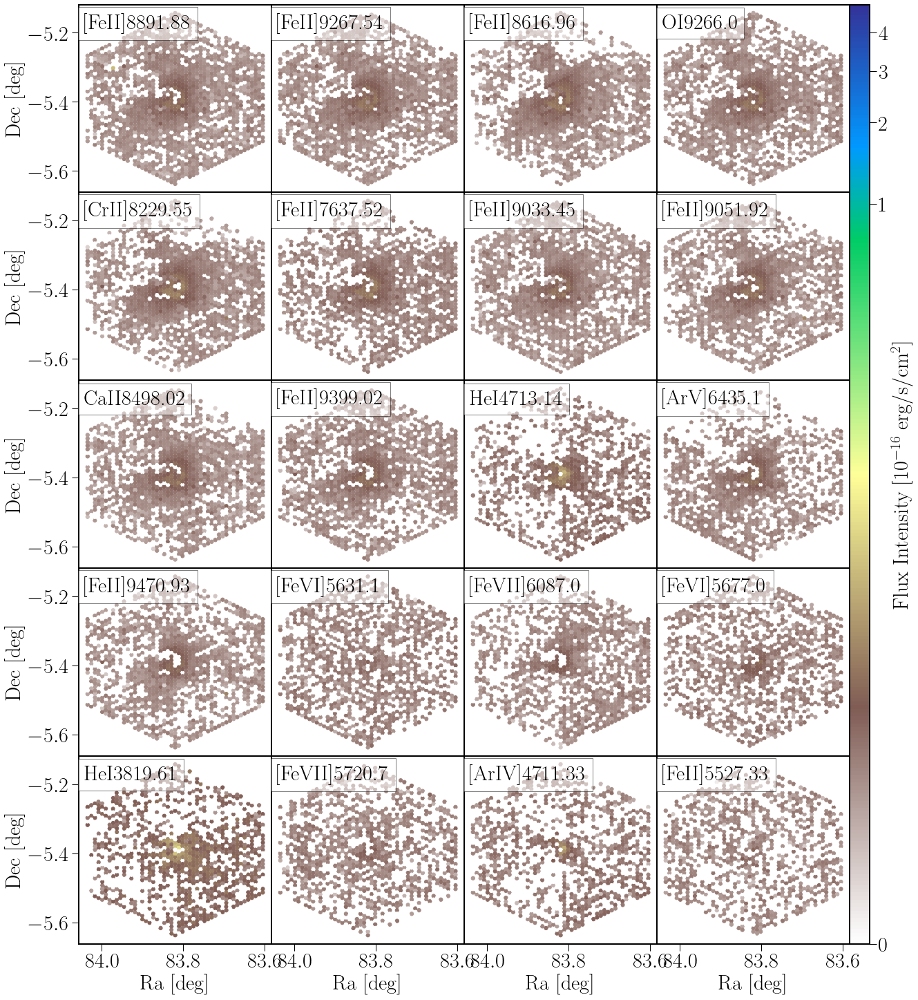

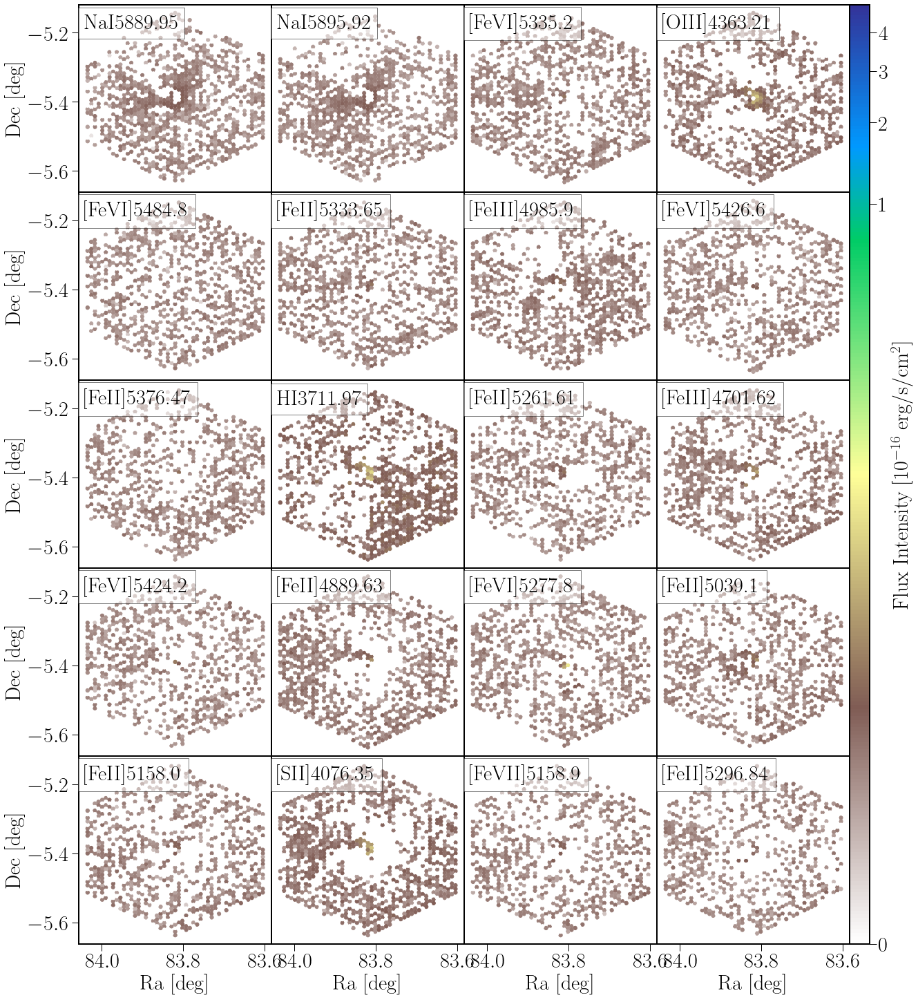

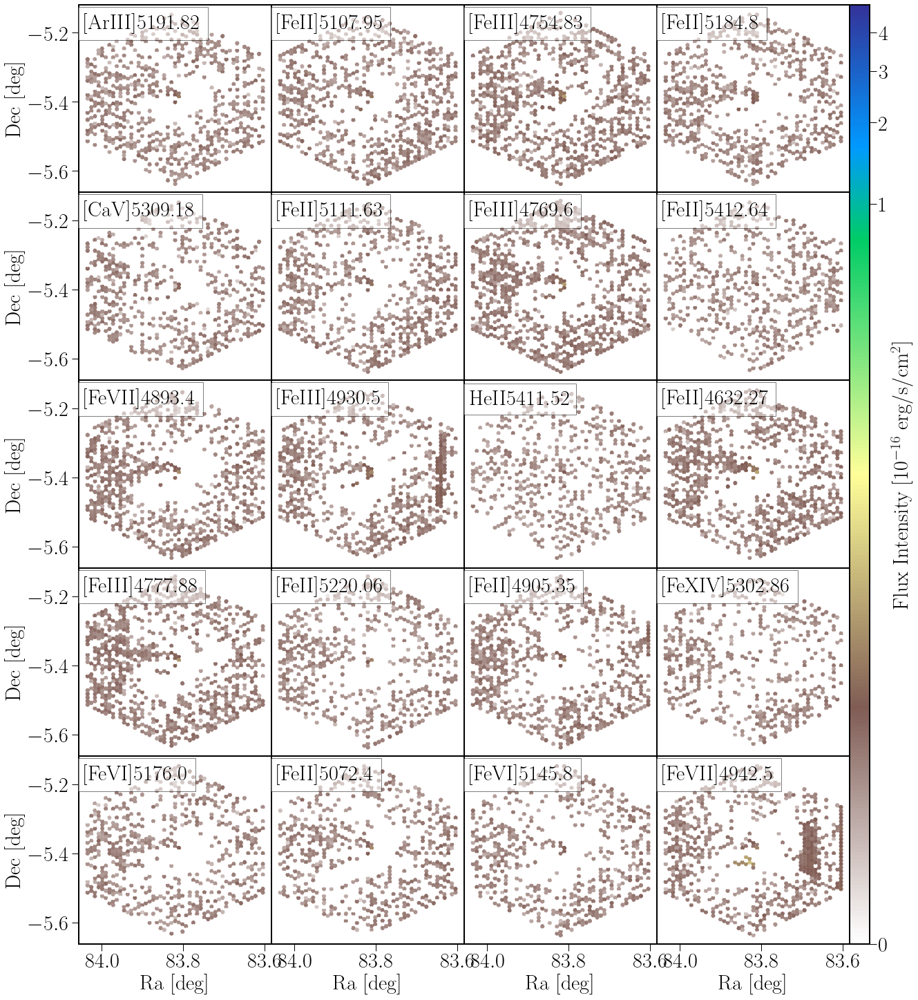

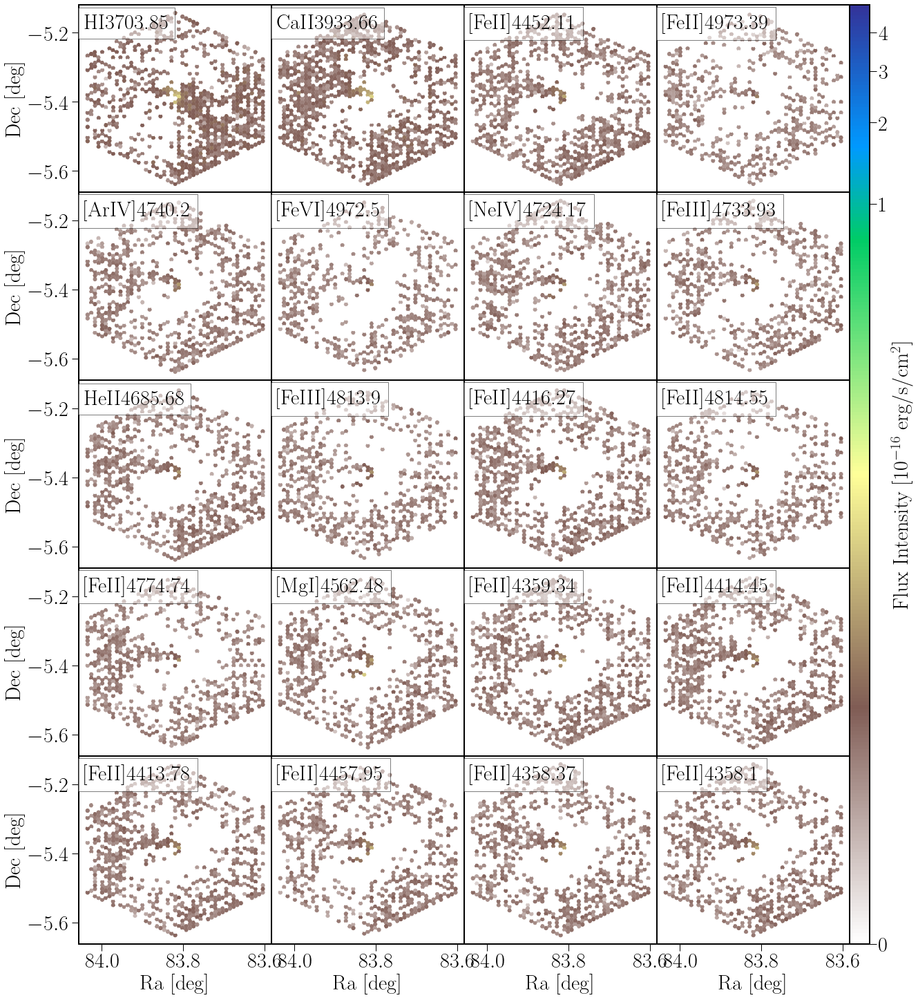

IndexError: index 192 out of range for table with length 192

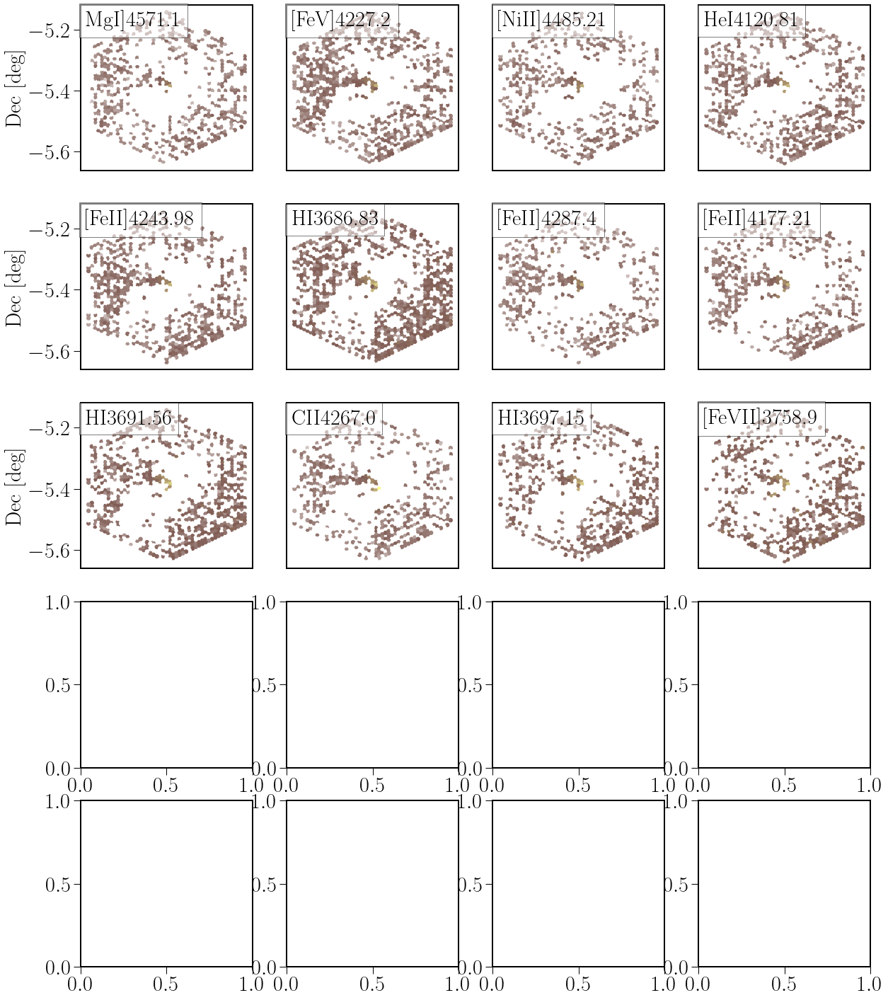

In [18]:
#cmap='gnuplot2_r'
#gamma=0.5
#cmap='pink_r'
#cmap='Spectral'
#cmap='nipy_spectral_r'
#cmap='cubehelix_r'
#cmap='terrain_r'
#fig = plt.figure()
NX=4
NY=5
I_now=0

for I0 in np.arange(0,len(tab_sum_flux),NX*NY):
    fig, axs = plt.subplots(nrows=NY, ncols=NX, figsize=(5*NX, 5*NY))#/1.3))


    #axs_flat = axs.flatten
    for I,ax in enumerate(np.ravel(axs)):
        #print(ax)
        tab_now=tab_sum_flux[I+I0]
        eline=tab_now['eline']
        wave=np.ceil(tab_now['wave'])
        II=str(I)
        if (I<10):
            II='0'+str(I)
        filename=f'30dor_{II}_{wave}'
        title=eline.replace('flux_','')
        title=title.replace('_','')
        title=title.replace('flux','')
        title=title.replace('alpha','$\\alpha$')
        title=title.replace('beta','$\\beta$')
        title=title.replace('gamma','$\\gamma$')    
        title=title.replace('delta','$\\delta$')
        title=title.replace('epsilon','$\\epsilon$')    
        xlab = False
        ylab = False
        if ((I/NX)==int(I/NX)):
            ylab=True
        else:
            ax.set_yticks([])
        if (I>=(NX*NY-4)):
            xlab=True
        else:
            ax.set_xticks([])
        vmin=0
        vmax=0.49e8
        
        scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline, \
                             vmin=0.1/f_scale, vmax=vmax/f_scale, title=title, filename=filename,\
             cmap=cmap, fsize=6.5, figs_dir='figs',gamma=gamma,fig_type='pdf',\
                         xlab=xlab,ylab=ylab,sf=2.8,fs=fs,\
                        f_scale=f_scale)
        
#        scat=map_plot_DAP_ax(tab_DAP,ax=ax,fig=fig,line=eline,vmin=0, vmax=vmax, title=title, filename=filename, cmap=cmap, fsize=6.5,\
#                             figs_dir='figs',gamma=gamma,fig_type='pdf',xlab=xlab,ylab=ylab,sf=2.8)
        xx = ax.get_xlim()
        yy = ax.get_ylim()
        #print(xx,yy)
    cax = fig.add_axes([0.9, 0.125, 0.02, 0.755])     
#    cax = fig.add_axes([0.9, 0.11, 0.02, 0.77]) 
#    cax = fig.add_axes([0.9, 0.125, 0.02, 0.76])  # Ajusta estos valores según necesites
    cbar = fig.colorbar(scat, cax=cax, ax=axs.ravel().tolist(), orientation='vertical')#, format='%.0e')
    cbar.set_label('Flux Intensity [10$^{-16}$ erg/s/cm$^2$]')
    plt.subplots_adjust(wspace=0,hspace=0)
    plt.show()    
    #fig.tight_layout(w_pad=0.2)
    fig.savefig(f'figs/ORION_felines_{I_now}.pdf', facecolor='white')
    I_now=I_now+1

#if (I>3):
    #    break

In [20]:
tab_DAP['flux_pe_6562.68']=tab_DAP['flux_pe_6562.85']
tab_DAP['e_flux_pe_6562.68']=tab_DAP['e_flux_pe_6562.85']


In [21]:
#
# Write table Latex
#

tab_fe = Table.read('output_dap/m_sel-ORION.fe.ecsv')
n_cut=0

a_name=[]
a_flux=[]
a_e_flux=[]
for cols in tab_fe.colnames:
    if ((cols.find('flux_')>-1)&(cols.find('e_')==-1)):
        e_cols=f'e_{cols}'
#        print(cols,e_cols)
        title=cols.replace('flux_','')
        title=title.replace('_','')
        title=title.replace('flux','')
        title=title.replace('alpha','$\\alpha$')
        title=title.replace('beta','$\\beta$')
        title=title.replace('gamma','$\\gamma$')    
        title=title.replace('delta','$\\delta$')
        title=title.replace('epsilon','$\\epsilon$')   
        flux = tab_fe[cols].value[0]/1000
        e_flux = tab_fe[e_cols].value[0]/1000
        if (flux>5*e_flux):
#            print(f'{title} {flux} {e_flux}'
            a_name.append(title)
            a_flux.append(flux)
            a_e_flux.append(e_flux)
            n_cut=n_cut+1

a_name=np.array(a_name)
a_flux=np.array(a_flux)
a_e_flux=np.array(a_e_flux)
print(n_cut)
        
#mask_fe = (tab_fe.colnames == 'flux_') & (tab_fe.colnames = 'flux_')


42


In [27]:
n_c=int(n_cut/3)
for I in range(n_c):
    print(' %s  & %5.2f  & %5.2f' % (a_name[I],a_flux[I],a_e_flux[I]),end='')
    print('& %s  & %5.2f  & %5.2f' % (a_name[I+n_c],a_flux[I+n_c],a_e_flux[I+n_c]),end='')
    print('& %s  & %5.2f  & %5.2f \\\\' % (a_name[I+2*n_c],a_flux[I+2*n_c],a_e_flux[I+2*n_c]))

    

 [OII]3726.03  & 2236.84  & 27.32& HeI4471.48  & 61.60  &  3.95& [OII]7318.92  & 102.68  &  4.60 \\
 [OII]3728.82  & 2195.95  & 28.11& [FeII]4474.91  & 62.15  &  2.52& [CaII]7323.88  & 97.23  &  5.14 \\
 HI3734.37  & 564.75  & 18.17& H$\beta$4861.36  & 1843.04  &  5.03& [OII]7329.66  & 78.72  &  4.76 \\
 [NeIII]3868.75  & 96.45  &  6.54& [OIII]5006.84  & 3541.54  & 196.12& [ArIII]7751.06  & 92.31  &  1.98 \\
 HeI3888.65  & 248.27  & 16.65& [NII]5754.59  & 16.00  &  2.90& OI8446.0  & 30.13  &  5.16 \\
 HI3889.05  & 247.07  & 17.18& HeI5876.0  & 216.26  &  2.94& HI8598.39  & 27.30  &  5.06 \\
 HeI3964.73  & 91.16  &  9.24& [OI]6300.3  & 19.76  &  2.67& HI8665.02  & 29.71  &  2.63 \\
 [NeIII]3967.46  & 256.05  &  9.26& [SIII]6312.06  & 30.97  &  2.55& HI8750.47  & 43.95  &  3.75 \\
 CaII3968.47  & 256.61  &  9.14& H$\alpha$6562.85  & 6219.77  &  1.23& HI8862.78  & 57.13  &  3.42 \\
 H$\epsilon$3970.07  & 254.50  &  9.30& [NII]6583.45  & 1281.78  & 42.73& [SIII]9069.0  & 1105.70  & 13.22 \

In [23]:
list_columns(tab_fe.colnames)

flux_HI_3686.83          disp_HI_3686.83          e_flux_HI_3686.83        e_disp_HI_3686.83        
flux_HI_3691.56          disp_HI_3691.56          e_flux_HI_3691.56        e_disp_HI_3691.56        
flux_HI_3697.15          disp_HI_3697.15          e_flux_HI_3697.15        e_disp_HI_3697.15        
flux_HI_3703.85          disp_HI_3703.85          e_flux_HI_3703.85        e_disp_HI_3703.85        
flux_HI_3711.97          disp_HI_3711.97          e_flux_HI_3711.97        e_disp_HI_3711.97        
flux_[OII]_3726.03       disp_[OII]_3726.03       e_flux_[OII]_3726.03     e_disp_[OII]_3726.03     
flux_[OII]_3728.82       disp_[OII]_3728.82       e_flux_[OII]_3728.82     e_disp_[OII]_3728.82     
flux_HI_3734.37          disp_HI_3734.37          e_flux_HI_3734.37        e_disp_HI_3734.37        
flux_HI_3750.15          disp_HI_3750.15          e_flux_HI_3750.15        e_disp_HI_3750.15        
flux_[FeVII]_3758.9      disp_[FeVII]_3758.9      e_flux_[FeVII]_3758.9    e_disp_[FeVII]_3

In [24]:
n=len(tab_fe.colnames)
n_fe=int(n/8)
print(n/2/4,n_fe)

192.0 192


In [25]:
for I in range(n_cut):
    if (a_name[I].find('beta')>-1):
#        print(' %s  & %5.2f  & %5.2f' % (a_name[I],a_flux[I],a_e_flux[I]))
        FHb = a_flux[I]
        e_FHb = a_e_flux[I]
        
for I in range(n_cut):
    if ((a_name[I].find('alpha')>-1) or (a_name[I].find('gamma')>-1) or (a_name[I].find('delta')>-1) or (a_name[I].find('epsilon')>-1) or (a_name[I].find('HI')>-1)):
#        print(' %s  & %5.2f  & %5.2f' % (a_name[I],a_flux[I],a_e_flux[I]))
        rat = a_flux[I]/FHb
        e_rat = a_e_flux[I]/FHb+e_FHb*rat/FHb
        print(' %s/H$\\beta$  & %5.2f $\pm$ %5.2f' % (a_name[I],rat,e_rat))
        
        

 HI3734.37/H$\beta$  &  0.31 $\pm$  0.01
 HI3889.05/H$\beta$  &  0.13 $\pm$  0.01
 H$\epsilon$3970.07/H$\beta$  &  0.14 $\pm$  0.01
 H$\delta$4101.77/H$\beta$  &  0.14 $\pm$  0.00
 H$\gamma$4340.49/H$\beta$  &  0.38 $\pm$  0.00
 H$\alpha$6562.85/H$\beta$  &  3.37 $\pm$  0.01
 HI8598.39/H$\beta$  &  0.01 $\pm$  0.00
 HI8665.02/H$\beta$  &  0.02 $\pm$  0.00
 HI8750.47/H$\beta$  &  0.02 $\pm$  0.00
 HI8862.78/H$\beta$  &  0.03 $\pm$  0.00
 HI9229.02/H$\beta$  &  0.06 $\pm$  0.00
 HI9545.97/H$\beta$  &  0.06 $\pm$  0.00
